## 1. Primera Exploración Dataset Reservas Hotel

Datos Kaggle: https://www.kaggle.com/datasets/jessemostipak/hotel-booking-demand

Dataset con datos de reservas en 2 hoteles de Portugal durante el periodo: 1 de julio de 2015 - 31 de agosto de 2017.

2 tipos de hoteles:

- City: hotel de ciudad (Lisboa)
- Resort: hotel de 'vacaciones' (Algarve)
<br>
<br>


In [1]:
import numpy as np
import pandas as pd

from scipy.stats import shapiro
from scipy.stats import skew
from scipy.stats import iqr
import phik
from sklearn.utils import shuffle

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

1.1. Visual General del Dataset

In [2]:
hoteles = pd.read_csv('../src:data/src:data:raw/hotel_bookings.csv', )
print("Nº de reservas:", hoteles.shape[0], "\nFeatures:", hoteles.shape[1])

hoteles.head()

Nº de reservas: 119390 
Features: 32


,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,2015-07-03


El proyecto elegido es un modelo de predicción de las cancelaciones en el hotel ciudad, por lo utilizaremos solo los datos del 'City Hotel':

| **Datos**| **Problema ML**| **N Observaciones**| **N Featuress**|
| :--- | :--- | :--- | :--- |
| Reservas de Hotel| Clasificación Binaria | 79330 | 31 |

In [3]:
hotel = hoteles[hoteles['hotel'] == 'City Hotel']
hotel.reset_index(drop=True, inplace=True)

# Eliminamos columna hotel ya que no usaremos las reservas del hotel resort
del hotel['hotel']
print("Observaciones Hotel:", hotel.shape)

# guardamos el dataset
hotel.to_csv('../src:data/src:data:raw/city_hotel.csv', encoding='utf-8')

Observaciones Hotel: (79330, 31)


In [4]:
# Creamos columnas --> ver 2_EDA

# Creamos columna N noches total --> ver 1.3. Variables numéricas
hotel['total_n_noches'] = hotel['stays_in_week_nights'] + hotel['stays_in_weekend_nights']

# Creamos columna 'arrival date' --> pasamos 'arrival_date_month' a formato datetime numérico (de January a 1)
hotel['arrival_date_month'] = pd.to_datetime(hotel['arrival_date_month'], format='%B').dt.month.astype(int)
hotel['arrival_date'] = pd.to_datetime(hotel['arrival_date_year'].map(str) +  "-" + hotel['arrival_date_month'].map(str) +\
                         "-" + hotel['arrival_date_day_of_month'].map(str))

# Pasamos status date a datetime para operar con columna 'arrival_date'
hotel['reservation_status_date'] = pd.to_datetime(hotel['reservation_status_date'])

# Calculamos N días entre la última modificacion y llegada:
hotel['dias_modificacion_llegada'] = hotel['arrival_date'] - hotel['reservation_status_date']

# Pasamos formato datetime a num de días (int)
hotel['dias_modificacion_llegada'] = hotel['dias_modificacion_llegada'].dt.days

# para ver todas las columnas
pd.options.display.max_columns = 34

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy

Resumen Datos Dataset con Nuevas Features


| **Datos**| **Problema ML**| **N Observaciones**| **N Featuress**|
| :--- | :--- | :--- | :--- |
| Reservas de Hotel| Clasificación Binaria | 79330 | 34 |

* Tras el análisis eliminaremos alguna columna para crear el modelo

In [5]:
# Resumen tipo de datos y nulos:
hotel.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 79330 entries, 0 to 79329
Data columns (total 34 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   is_canceled                     79330 non-null  int64         
 1   lead_time                       79330 non-null  int64         
 2   arrival_date_year               79330 non-null  int64         
 3   arrival_date_month              79330 non-null  int64         
 4   arrival_date_week_number        79330 non-null  int64         
 5   arrival_date_day_of_month       79330 non-null  int64         
 6   stays_in_weekend_nights         79330 non-null  int64         
 7   stays_in_week_nights            79330 non-null  int64         
 8   adults                          79330 non-null  int64         
 9   children                        79326 non-null  float64       
 10  babies                          79330 non-null  int64         
 11  me

In [6]:
# MISSINGS
'''
Variables con valores nulos:
- Children 
- Country 
- Agent 
- Company --> 94% de nulos
'''
nulos = pd.DataFrame(hotel.isna().sum(), columns=['nulos'])
nulos['perc'] = round(hotel.isna().sum()/hotel.shape[0] * 100, 2)
nulos[nulos['nulos'] > 0]

,nulos,perc
children,4,0.01
country,24,0.03
agent,8131,10.25
company,75641,95.35


In [7]:
# Los nulos de agent, no significa que se hayan reservado a través de company
print(nulos['nulos']['company'] + nulos['nulos']['agent'] - hotel.shape[0])

4442


In [8]:
# Los 4 nulos de children son reservas canceladas 
# Reservadas todas en agosto con muy poca antelación --> 3 de ellas con un adr muy bajo: 12 y 18€
# Tampoco había bebés en la reserva y el tipo de cliente es Transient-Party 

hotel[hotel['children'].isna()]
hotel[hotel['children'].isna()]['babies']
hotel[hotel['customer_type'] == 'Transient-Party']['children'].value_counts()[0] / len(hotel[hotel['customer_type'] == 'Transient-Party'])

0.9813650262505048

In [9]:
# Tratamos nulos

#     children--> 0, entendemos que en esas 4 reservas no había ningún niño
hotel['children'].fillna(0, inplace = True)

#     country --> NA, ya que representa que no tenemos información del país de procedencia
hotel['country'].fillna('NA', inplace = True)

#     agent--> 0 para representar que ningún agente o agencia realizó la reserva
hotel['agent'].fillna(0, inplace = True)

#     company --> 0, para representar que ningún agente realizó la reserva (esta columna la eliminaremos para ML)
hotel['company'].fillna(0, inplace = True)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/generic.py:6392: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return self._update_inplace(result)


In [10]:
# Resumen datos (función del nb 'ML_Guide_Clase')
def data_report(df):
    
    # Sacamos los NOMBRES
    cols = pd.DataFrame(df.columns.values, columns = ['COL_N'])

    # Sacamos los TIPOS --> tipo de cada columna
    types = pd.DataFrame(df.dtypes.values, columns = ['DATA_TYPE'])

    # Sacamos los MISSINGS --> df % nulos por columna
    percent_missing = round(df.isnull().sum()*100 / len(df), 2)
    percent_missing_df = pd.DataFrame(percent_missing.values, columns = ['MISSINGS (%)'])
    
    # Sacamos los VALORES UNICOS --> % cuantos valores unicos hay respecto a todos los valores
    unicos = pd.DataFrame(df.nunique().values, columns = ['UNIQUE_VALUES'])

    percent_candin = round(unicos['UNIQUE_VALUES']*100 / len(df), 2)
    percent_candin_df = pd.DataFrame(percent_candin.values, columns = ['CARDIN (%)'])

    # Unimos
    concatenado = pd.concat([cols, types, percent_missing_df, unicos, percent_candin_df], axis = 1)
    concatenado.set_index('COL_N', drop = True, inplace = True)

    return concatenado.T

data_report_hotel = data_report(hotel) 
data_report_hotel

COL_N,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,total_n_noches,arrival_date,dias_modificacion_llegada
DATA_TYPE,int64,int64,int64,int64,int64,int64,int64,int64,int64,float64,int64,object,object,object,object,int64,int64,int64,object,object,int64,object,float64,float64,int64,object,float64,int64,int64,object,datetime64[ns],int64,datetime64[ns],int64
MISSINGS (%),0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
UNIQUE_VALUES,2,453,3,12,53,31,14,29,5,4,5,4,167,8,5,2,10,73,8,9,21,3,224,208,115,4,5405,4,6,3,864,37,793,409
CARDIN (%),0.0,0.57,0.0,0.02,0.07,0.04,0.02,0.04,0.01,0.01,0.01,0.01,0.21,0.01,0.01,0.0,0.01,0.09,0.01,0.01,0.03,0.0,0.28,0.26,0.14,0.01,6.81,0.01,0.01,0.0,1.09,0.05,1.0,0.52


In [11]:
# Hay 25902 duplicados, pero como no hay una columna que identifique cada reserva, 
# y no sería raro que se repitan los mismos valores en varias reservas, las dejamos
len(hotel[hotel.duplicated()])

25902

1.2. Columnas Numéricas

| **Variables Numéricas**|
| :---: |

| **Feature**| **Descripción**| 
| :--- |  :--- |
| 'lead_time' | N días entre que se hizo la reserva y la fecha de llegada |
| 'stay_in_week_nights' | N de noches entre semana (L-V) de la reserva |
| 'stays_in_weekend_nights' | N de noches de fin de semana (S-D) de la reserva |
| 'adult' | N adultos por reserva |
| 'children' | N niños por reserva |
| 'babies' | N bebés por reserva | 
| 'previous_cancellation'| N de cancelaciones, anteriores a la reserva, realizadas por el huésped |
| 'previous_bookings_not_cancelled' | N de reservas, anteriores a la reserva de la observación, no canceladas |
| 'booking_changes' | N cambios realizados en la reserva |
| 'days_in_waiting_list' | N de días que la reserva estuvo en lista de espera |
| 'adr' | Tarifa Media Diaria de la hab |
| 'required_car_parking_spaces' | N de plazas de parking reservadas |
| 'total_of_special_requests' | N de peticiones especiales |
| 'total_n_noches' | Creada a partir de  'stays_in_weekend_nights' +  'stay_in_week_nights': n noches totales de estancia |
| 'dias_modificacion_llegada' | Días entre la fecha de la última modificacion hecha en la reserva y la fecha de llegada |

In [12]:
hotel.describe().T # de las 20 columnas numéricas

,count,mean,std,min,25%,50%,75%,max
is_canceled,79330.0,0.417270,0.493111,0.0,0.0,0.0,1.0,1.0
lead_time,79330.0,109.735724,110.948526,0.0,23.0,74.0,163.0,629.0
arrival_date_year,79330.0,2016.174285,0.699181,2015.0,2016.0,2016.0,2017.0,2017.0
arrival_date_month,79330.0,6.556473,3.042898,1.0,4.0,7.0,9.0,12.0
arrival_date_week_number,79330.0,27.177449,13.398523,1.0,17.0,27.0,38.0,53.0
arrival_date_day_of_month,79330.0,15.786625,8.728451,1.0,8.0,16.0,23.0,31.0
stays_in_weekend_nights,79330.0,0.795185,0.885026,0.0,0.0,1.0,2.0,16.0
stays_in_week_nights,79330.0,2.182957,1.456416,0.0,1.0,2.0,3.0,41.0
adults,79330.0,1.850977,0.509292,0.0,2.0,2.0,2.0,4.0
children,79330.0,0.091365,0.372168,0.0,0.0,0.0,0.0,3.0


In [13]:
# Vemos distribuciones en columnas numéricas
# saphiro: comprobar cuánto de normal es una variable --> vemos que NO tienen distribución normal, si transformamos a log sí
# shapiro: si < 0.05 --> distr no normal 


var_numericas = ['is_canceled', 'lead_time', 'stays_in_weekend_nights', 'stays_in_week_nights', 'total_n_noches', 'adults', 'children', 'babies', 'is_repeated_guest', 'previous_cancellations', 
'previous_bookings_not_canceled', 'booking_changes', 'days_in_waiting_list', 'adr', 'required_car_parking_spaces', 
'total_of_special_requests', 'dias_modificacion_llegada']

'''
La primera vez que lo intentamos nos salio este mensaje y pvalues con valores 0 ó 1 --> seleccionamos una muestra de 4000 filas para obtenerlo
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/scipy/stats/morestats.py:1760: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")

'''

hotel = shuffle(hotel)
hotel_distr = hotel[:4000].reset_index(drop=True)

distribucion = []

for columna in hotel_distr[var_numericas]:
    distribucion.append([columna, shapiro(hotel[columna]).pvalue, shapiro(np.log(hotel[columna])).pvalue, skew(hotel[columna])])

distribucion_df = pd.DataFrame(distribucion)
distribucion_df.columns = ['columna', 'shapiro','shaphiro_log', 'skew'] 

distribucion_df.loc[distribucion_df['skew'] > 0, 'tipo_sew'] = 'derecha'
distribucion_df.loc[distribucion_df['skew'] < 0, 'tipo_sew'] = 'izquierda'
distribucion_df.loc[distribucion_df['skew'] == 0, 'tipo_sew'] = 'simetrica'

distribucion_df

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/scipy/stats/morestats.py:1760: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/arraylike.py:364: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/arraylike.py:364: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


,columna,shapiro,shaphiro_log,skew,tipo_sew
0,is_canceled,0.0,1.0,0.335547,derecha
1,lead_time,0.0,1.0,1.389808,derecha
2,stays_in_weekend_nights,0.0,1.0,1.133822,derecha
3,stays_in_week_nights,0.0,1.0,2.955938,derecha
4,total_n_noches,0.0,1.0,3.924061,derecha
5,adults,0.0,1.0,-0.430799,izquierda
6,children,0.0,1.0,4.337147,derecha
7,babies,0.0,1.0,44.774549,derecha
8,is_repeated_guest,0.0,1.0,6.005551,derecha
9,previous_cancellations,0.0,1.0,16.584585,derecha


In [14]:
# Función para calcular outliers --> del nb 'Detección de anomalías'

def outliers_IQR(data):

    q25 = np.percentile(data, 25)
    q75 = np.percentile(data, 75)
    iqr = q75 -q25

    cutoff = iqr * 1.5
    lower = q25 - cutoff
    upper = q75 + cutoff
    print("Lower:", lower,"Upper:", upper)

    pos = []
    k = 0

    for x in data:
        if x < lower or x > upper:
            pos.append(k)

        k += 1

    return pos  

In [15]:
# Función datos para tabla resumen nb 3_limpieza_trataminento
def datos_tabla(columna):

   print("Mean:", hotel[columna].mean())
   print("Median:", hotel[columna].median())
   print("Min:", hotel[columna].min())
   print("Max:", hotel[columna].max())
   print("IQR:", iqr(hotel[columna], nan_policy='omit'))
   print("CARDIN (%)", data_report_hotel.loc["CARDIN (%)"][columna])
   
   # outliers
   n_outliers = len(outliers_IQR(hotel[columna]))

   print("N outliers:", n_outliers)
   print("Perc outliers:", round(n_outliers / len(hotel[columna]) * 100, 2))

In [16]:
# LEAD TIME --> Nº días entre que se introdujo la reserva en el sistema y el día de llegada
#               Con cuántos días de antelación se reserva
datos_tabla('lead_time')

Mean: 109.73572419009201
Median: 74.0
Min: 0
Max: 629
IQR: 140.0
CARDIN (%) 0.57
Lower: -187.0 Upper: 373.0
N outliers: 2576
Perc outliers: 3.25


In [17]:
# El 70% de outliers en 'lead_time' son reservas que se cancelan --> a mayor antelación en la reserva, mayor probabilidad de que se cancele
# Mantenemos los outliers para el análisis

len(hotel.loc[(hotel['lead_time'] > 373) & hotel['is_canceled'] == 1]) / 2576

0.7003105590062112

In [18]:
# HISTOGRAMA

fig = px.histogram(hotel, x="lead_time")
fig.show()

hotel['lead_time'].describe()

count    79330.000000
mean       109.735724
std        110.948526
min          0.000000
25%         23.000000
50%         74.000000
75%        163.000000
max        629.000000
Name: lead_time, dtype: float64

In [19]:
# LEAD TIME --> 3.25% de outliers
# TIME IN WAITING LIST --> Nº de días, antes de la confirmación, que la reserva estuvo en lista de espera
#                      --> Muy pocas reservas (4.34%) entran en lista de espera

n_waiting = 0
for reserva in hotel['days_in_waiting_list']:
    if reserva != 0:
        n_waiting += 1

print("Reservas en espera:", n_waiting)
print("Peso del total de reservas:", round(n_waiting/hotel.shape[0] * 100, 2))  

fig = go.Figure()

fig.add_trace(go.Box(name = 'lead_time', x=hotel["lead_time"], marker_color = '#4620ff'))
fig.add_trace(go.Box(name = 'days_in_waiting_list', x=hotel['days_in_waiting_list'], marker_color = '#4620ff'))

fig.update_layout(barmode='group', uniformtext_minsize=12, uniformtext_mode='hide', font_family = 'Arial', title_font_family='Arial', 
                        plot_bgcolor='#efefef', paper_bgcolor='#efefef',showlegend=False)

fig.show()

Reservas en espera: 3443
Peso del total de reservas: 4.34


In [20]:
days_waiting_list = hotel['days_in_waiting_list'][hotel['days_in_waiting_list'] != 0]
days_waiting_list.describe()

print("Reservas con más de 3 meses en lista de espera:", len(days_waiting_list[days_waiting_list > 90]))
print("Reservas con más de 6 meses en lista de espera:", len(days_waiting_list[days_waiting_list > 180]))


Reservas con más de 3 meses en lista de espera: 843
Reservas con más de 6 meses en lista de espera: 274


In [21]:
datos_tabla('days_in_waiting_list') # Vemos que todos los valores son considerados outliers ???? --> no los eliminamos, ver si nos interesa esta columna para el análisis
                                    # --> sólo el 4.34 % de reservas entran el listas de espera, por lo que entendemos que cualquier valor != 0 es un outlier

Mean: 3.2267742342115215
Median: 0.0
Min: 0
Max: 391
IQR: 0.0
CARDIN (%) 0.14
Lower: 0.0 Upper: 0.0
N outliers: 3443
Perc outliers: 4.34


In [22]:
datos_tabla('dias_modificacion_llegada')

Mean: 35.540980713475356
Median: -1.0
Min: -57
Max: 526
IQR: 41.0
CARDIN (%) 0.52
Lower: -64.5 Upper: 99.5
N outliers: 11116
Perc outliers: 14.01


In [23]:
hotel[['dias_modificacion_llegada', 'reservation_status']].groupby(by='reservation_status').median()

,dias_modificacion_llegada
reservation_status,
Canceled,58.0
Check-Out,-3.0
No-Show,0.0


In [24]:
# Todos los outliers son reservas canceladas --> a mayor antelación en la reserva, mayor probabilidad de que se cancele
# Mantenemos los outliers para el análisis

len(hotel.loc[(hotel['dias_modificacion_llegada'] > 99.5) & (hotel['dias_modificacion_llegada'] > -64.5) & (hotel['is_canceled'] == 1)]) / 11819

0.940519502495981

In [25]:
# Todas las reservas con valores negativos, representan la duración de la estancia de las reservas no canceladas,
# ya que sería la fecha de llegada - la fecha de check-out --> es decir, esta columna sería equivalente a la de total n noches para todas las reservas no canceladas
# Pendiente ver si es útil esta columna creada por nosotros

len(hotel[hotel['dias_modificacion_llegada'] < 0])
len(hotel[(hotel['dias_modificacion_llegada'] < 0) & (hotel['reservation_status'] == 'Check-Out')])

45915

In [26]:
# De todos los valores negativos (representan duración de la estancia de las no cancelaciones), solo 1 no coincide con el total de noches de estancia
estancia_prueba = hotel[(hotel['dias_modificacion_llegada'] < 0) & (hotel['reservation_status'] == 'Check-Out')][['dias_modificacion_llegada', 'total_n_noches']]
estancia_prueba[abs(estancia_prueba['dias_modificacion_llegada']) != estancia_prueba['total_n_noches']]

# Reserva de 9 noches con fecha llegada 22-12-15(reserva hecha 3 días antes de la llegada), estado check-out pero última modificación 23-12-2015 --> interpreto error, eliminaremos esta fila
hotel[(hotel['dias_modificacion_llegada'] == -1) & (hotel['total_n_noches'] == 9)]

,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,total_n_noches,arrival_date,dias_modificacion_llegada
6121,0,3,2015,12,52,22,2,7,1,0.0,0,BB,PRT,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,9.0,0.0,0,Transient,67.5,0,0,Check-Out,2015-12-23,9,2015-12-22,-1


In [27]:
fig = go.Figure()

fig.add_trace(go.Histogram(x=hotel['dias_modificacion_llegada'], marker_color = '#4620ff'))

fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide', font_family = 'Arial', title_font_family='Arial', 
                        plot_bgcolor='#efefef', paper_bgcolor='#efefef',showlegend=True, )
fig.update_traces(texttemplate='%{text:.f}')
fig.update_yaxes(visible = False)

fig.show()

In [28]:
# STAY NOCHES DE SEMANA --> n noches de semana que se reservó el hotel 
datos_tabla('stays_in_week_nights')

Mean: 2.1829572671120636
Median: 2.0
Min: 0
Max: 41
IQR: 2.0
CARDIN (%) 0.04
Lower: -2.0 Upper: 6.0
N outliers: 719
Perc outliers: 0.91


In [29]:
# En este caso dejamos los outliers, ya que puede darse el caso de estancias largas de hotel 
# 58.6 % de outliers (+6 noches) cancelan
len(hotel.loc[(hotel['stays_in_week_nights'] > 6) & (hotel['is_canceled'] == 1)]) / 719

0.5966620305980529

In [30]:
# NOCHES DE FIN DE SEMANA --> n noches de fin de semana que se reservó el hotel
# Lo mismo que con noches de semana, outliers se deberían a estancias largas
datos_tabla('stays_in_weekend_nights')

Mean: 0.7951846716248582
Median: 1.0
Min: 0
Max: 16
IQR: 2.0
CARDIN (%) 0.02
Lower: -3.0 Upper: 5.0
N outliers: 82
Perc outliers: 0.1


In [31]:
hotel['stays_in_week_nights'].describe()
print(" Noches Semana > 2 Noches:", round(len(hotel[hotel['stays_in_week_nights'] > 3]) / len(hotel) * 100, 2))
print(" Noches Fin de Semana > 1 Noches:", round(len(hotel[hotel['stays_in_weekend_nights'] > 2]) / len(hotel) * 100, 2))

 Noches Semana > 2 Noches: 13.24
 Noches Fin de Semana > 1 Noches: 0.94


In [32]:
# 4963 reservas con errata --> ni noches entre semana ni noches por semana
len(hotel[(hotel['stays_in_week_nights'] == 0) & (hotel['stays_in_week_nights'] == 0)])

# el error debe estar en marcar las noches, ya que de todas esas noches solo 1480 fueron canceladas
len(hotel[(hotel['stays_in_week_nights'] == 0) & (hotel['stays_in_week_nights'] == 0) & (hotel['is_canceled'] == 1)])

1480

In [33]:
# GRÁFICO

fig = go.Figure()
fig.add_trace(go.Histogram(name = 'noches_findesemana', x=hotel['stays_in_weekend_nights'], marker_color = '#4620ff'))
fig.add_trace(go.Histogram(name = 'noches_semana', x=hotel['stays_in_week_nights'], marker_color = '#D7DCFF'))

fig.show()

# GRÁFICO b

fig = go.Figure()
fig.add_trace(go.Histogram(name = 'noches_findesemana', x=hotel['stays_in_weekend_nights'], marker_color = '#D7DCFF'))
fig.add_trace(go.Histogram(name = 'noches_semana', x=hotel['stays_in_week_nights'], marker_color = '#4620ff'))
fig.update_xaxes(range=[0.5, 5.5])

fig.update_layout(barmode='group', uniformtext_minsize=12, uniformtext_mode='hide', font_family = 'Arial', title_font_family='Arial', 
                        plot_bgcolor='#efefef', paper_bgcolor='#efefef',showlegend=True)

fig.show()

In [34]:
# N TOTAL DE NOCHES --> variables creada a partir de noches semana y noches fin de semana

hotel['total_n_noches'].describe() # --> media 3 noches
datos_tabla('total_n_noches')

Mean: 2.978141938736922
Median: 3.0
Min: 0
Max: 57
IQR: 2.0
CARDIN (%) 0.05
Lower: -1.0 Upper: 7.0
N outliers: 1248
Perc outliers: 1.57


In [35]:
# En este caso tampoco eliminamos ya que representan las estancias largas de hotel
# 54 % cancelan
len(hotel.loc[(hotel['total_n_noches'] > 7) & (hotel['is_canceled'] == 1)]) / 1248

0.5416666666666666

In [36]:
# ESTANCIA 

fig = go.Figure()

fig.add_trace(go.Box(name = 'Estancia Media', x=hotel["total_n_noches"], marker_color = '#4620ff'))

fig.update_layout(barmode='group', uniformtext_minsize=12, uniformtext_mode='hide', font_family = 'Arial', title_font_family='Arial', 
                        plot_bgcolor='#efefef', paper_bgcolor='#efefef',showlegend=False)

fig.show()

In [37]:
# HUESPED: adult, children, babies
# Mayoría 2 adultos, sin bebés ni niños

print("Porcentaje reservas sin niños:", round(len(hotel[hotel['children'] == 0])/len(hotel) *100, 2))
print("Porcentaje reservas sin bebés:", round(len(hotel[hotel['babies'] == 0])/len(hotel) *100, 2))

fig = go.Figure()
fig.add_trace(go.Histogram(name = 'adults', x=hotel['adults']))
fig.add_trace(go.Histogram(name = 'children', x=hotel['babies']))
fig.add_trace(go.Histogram(name = 'babies', x=hotel['children']))

fig.show()

Porcentaje reservas sin niños: 93.56
Porcentaje reservas sin bebés: 99.53


In [38]:
hotel['adults'].describe()

count    79330.000000
mean         1.850977
std          0.509292
min          0.000000
25%          2.000000
50%          2.000000
75%          2.000000
max          4.000000
Name: adults, dtype: float64

In [39]:
datos_tabla('adults') # alto porcentaje de outliers 
                      # aquí tenemos una errata?? --> representan 

Mean: 1.8509769318038574
Median: 2.0
Min: 0
Max: 4
IQR: 0.0
CARDIN (%) 0.01
Lower: 2.0 Upper: 2.0
N outliers: 21075
Perc outliers: 26.57


In [40]:
hotel.loc[hotel['adults'] > 2]['customer_type'].value_counts() # ---> 4411 outliers que son de tipo Transient

# Pero vemos que + de 3 adultos, son solo 30 transients y 1 transient-group: --> 0.1 de los outliers, no eliminamos ya que el max de adulto es 4 y podría ser
hotel.loc[hotel['adults'] > 3]['customer_type'].value_counts()
len(hotel.loc[hotel['adults'] > 3]) / 21075

0.0014709371293001186

In [41]:
datos_tabla('children')

Mean: 0.0913651834110677
Median: 0.0
Min: 0.0
Max: 3.0
IQR: 0.0
CARDIN (%) 0.01
Lower: 0.0 Upper: 0.0
N outliers: 5106
Perc outliers: 6.44


In [42]:
hotel['children'].unique() # aunque hay un 6.44% de outliers porque lo común es 0 niños, no los quitamos ya que tiene sentido de 0 - 3 niños

array([0., 2., 1., 3.])

In [43]:
datos_tabla('babies')

Mean: 0.0049413840917685616
Median: 0.0
Min: 0
Max: 10
IQR: 0.0
CARDIN (%) 0.01
Lower: 0.0 Upper: 0.0
N outliers: 369
Perc outliers: 0.47


In [44]:
print(hotel['babies'].unique()) # ¿reservas con 9 y 10 bebés?

# son dos reservas --> una tiene tipo Transient-Party (problema de si falta var número de habitacion, si es así, tendría sentido)
#                      pero n de adultos es 1 y 2, parece muy atípico: las eliminamos
hotel[hotel['babies'] > 8]

[ 0  1  2 10  9]


,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,total_n_noches,arrival_date,dias_modificacion_llegada
6559,0,37,2016,1,3,12,0,2,2,0.0,10,BB,PRT,Online TA,TA/TO,0,0,0,D,D,1,No Deposit,9.0,0.0,0,Transient,84.45,0,1,Check-Out,2016-01-14,2,2016-01-12,-2
38596,0,11,2015,10,42,11,2,1,1,0.0,9,BB,GBR,Corporate,Corporate,0,0,0,A,B,1,No Deposit,95.0,0.0,0,Transient-Party,95.00,0,0,Check-Out,2015-10-14,3,2015-10-11,-3


In [45]:
# 167 reservas sin adulto, bebés o niños --> solo 23 canceladas --> eliminamos
reservas_sin_personas = hotel[(hotel['adults'] == 0) & (hotel['children'] == 0) & (hotel['babies'] == 0)]
len(reservas_sin_personas[reservas_sin_personas['is_canceled'] == 1])

23

In [46]:
# 3 reservas con bebés pero sin adultos --> eliminamos
hotel[(hotel['adults'] == 0) & (hotel['babies'] > 0)]

,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,total_n_noches,arrival_date,dias_modificacion_llegada
50730,0,14,2016,6,24,9,0,3,0,2.0,1,BB,ITA,Online TA,TA/TO,0,0,0,B,B,2,No Deposit,9.0,0.0,0,Transient,116.49,0,2,Check-Out,2016-06-12,3,2016-06-09,-3
41315,1,22,2015,12,50,9,1,4,0,2.0,1,BB,PRT,Direct,Direct,0,0,0,B,B,1,No Deposit,14.0,0.0,0,Transient,80.75,0,1,No-Show,2015-12-09,5,2015-12-09,0
6090,0,6,2015,12,51,18,0,1,0,2.0,1,BB,PRT,Online TA,TA/TO,0,0,0,B,B,0,No Deposit,9.0,0.0,0,Transient-Party,77.00,0,2,Check-Out,2015-12-19,1,2015-12-18,-1


!! Pocas reservas con o sin cancelaciones anteriores --> pero sería una variable importante

In [47]:
# is_repeated_guest (1: huésped que repite / 0: nuevo)
#          --> solo 2032 reservas
# de todos los huespedes que repiten --> 21% cancela

for columna in hotel[['is_repeated_guest', 'previous_cancellations', 'previous_bookings_not_canceled']]:

    print(columna, len(hotel[hotel[columna] > 0]))

print()
print("Huespedes que repiten y cancelan:", len(hotel[(hotel['is_repeated_guest'] > 0) & (hotel['is_canceled'] == 1)]))
print("Peso:", len(hotel[(hotel['is_repeated_guest'] > 0) & (hotel['is_canceled'] == 1)]) / len(hotel[hotel['is_repeated_guest'] > 0]))

# Cuantas cancelaciones con cancelaciones anteriores --> 5942
len(hotel[(hotel['previous_cancellations'] > 0) & (hotel['is_canceled'] == 1)])

# Gráfico (PIE)
labels = ['Reservas Canceladas', 'No Canceladas']
values = [len(hotel[(hotel['previous_cancellations'] > 0) & (hotel['is_canceled'] == 1)]), 
            len(hotel[hotel['previous_cancellations'] > 0]) - len(hotel[(hotel['previous_cancellations'] > 0) & (hotel['is_canceled'] == 1)])]

fig = px.pie(values=values, #labels=labels, 
#names= labels,
width = 600, height=450,
title = "<b>Cancelaciones con Cancelaciones Anteriores<b>", hover_name=labels,
color = labels, color_discrete_map={'Reservas Canceladas': '#4620ff', 'No Canceladas': '#D7DCFF'}
)

fig.update_traces(marker=dict(line=dict(color='white', width=0.5)),
                  hovertemplate = values, #textinfo = 'label+text',
                  textposition='inside'
                  )

fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig.update_layout(font_family = 'Arial', title_font_family='Arial')
fig.show()

# Cuantas cancelaciones sin cancelaciones anteriores --> 200
len(hotel[(hotel['previous_bookings_not_canceled'] > 0) & (hotel['is_canceled'] == 1)])

# Gráfico (PIE)
labels_ = ['Reservas No Canceladas', 'Canceladas']
values_ = [len(hotel[(hotel['previous_bookings_not_canceled'] > 0) & (hotel['is_canceled'] == 0)]), 
            len(hotel[hotel['previous_bookings_not_canceled'] > 0]) - len(hotel[(hotel['previous_bookings_not_canceled'] > 0) & (hotel['is_canceled'] == 0)])]

fig = px.pie(values=values_,
width = 600, height=450,
title = "<b>No Cancelaciones con No Cancelaciones Anteriores<b>", hover_name=labels,
color = labels, color_discrete_map={'Reservas Canceladas': '#4620ff', 'No Canceladas': '#D7DCFF'}
)

fig.update_traces(marker=dict(line=dict(color='white', width=0.5)),
                  hovertemplate = values, #textinfo = 'label+text',
                  textposition='inside'
                  )

fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig.update_layout(font_family = 'Arial', title_font_family='Arial')
fig.show()

is_repeated_guest 2032
previous_cancellations 5389
previous_bookings_not_canceled 1588

Huespedes que repiten y cancelan: 441
Peso: 0.2170275590551181


In [48]:
# 'is_repeated_guest' -- > Columna numérica pero de clasificación binaria: 
# 1: repite
# 0: no repite

# 'previous_cancellations'
datos_tabla('previous_cancellations')

Mean: 0.07974284633808143
Median: 0.0
Min: 0
Max: 21
IQR: 0.0
CARDIN (%) 0.01
Lower: 0.0 Upper: 0.0
N outliers: 5389
Perc outliers: 6.79


In [49]:
print(hotel['previous_cancellations'].unique()) 

# La mayoría de outliers están entre 1 y  2 cancelaciones previas --> si quitamos estos datos, sería como eliminar la columna
hotel[(hotel['previous_cancellations'] > 0) & (hotel['previous_cancellations'] < 3)]

# Vemos que de las 111 reservas con + 3 cancelaciones previas, 98 también tienen reservas previas no canceladas
len(hotel[hotel['previous_cancellations'] > 3]) # 111
len(hotel[(hotel['previous_cancellations'] > 3) & (hotel['previous_bookings_not_canceled'] > 0)]) # 98


# Podría tratarse de errores o pruebas del hotel
# También prodrían ser huéspedes muy habituales --> 97 de las 111 reservas con + 3 cancelaciones, son huéspedes que repite
#                                               -->  # 86 de las 111 reservas con + de 3 cancelaciones, también tienen + 3 reservas anteriores no canceladas
#                                               Interpretamos que son huéspedes muy habituales y por eso tienen un % más alto de reservas, dejamos outliers
len(hotel[(hotel['previous_cancellations'] > 3) & (hotel['is_repeated_guest'] == 1)]) # 97
len(hotel[(hotel['previous_cancellations'] > 3) & (hotel['previous_bookings_not_canceled'] > 3)]) # 86

[ 0  1  2  4  3  5 11  6 13 21]


86

In [50]:
datos_tabla('previous_bookings_not_canceled')

Mean: 0.13237110802974916
Median: 0.0
Min: 0
Max: 72
IQR: 0.0
CARDIN (%) 0.09
Lower: 0.0 Upper: 0.0
N outliers: 1588
Perc outliers: 2.0


In [51]:
hotel[hotel['previous_bookings_not_canceled'] > 0]

,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,total_n_noches,arrival_date,dias_modificacion_llegada
48394,0,0,2017,6,23,7,0,1,1,0.0,0,BB,PRT,Aviation,Corporate,1,0,2,A,A,0,No Deposit,0.0,153.0,0,Transient,144.0,0,2,Check-Out,2017-06-08,1,2017-06-07,-1
56247,0,94,2017,6,22,2,0,1,2,0.0,0,BB,PRT,Complementary,Direct,1,0,1,F,F,1,No Deposit,0.0,45.0,0,Transient,0.0,1,4,Check-Out,2017-06-03,1,2017-06-02,-1
39608,0,1,2017,3,9,4,0,1,2,0.0,1,BB,PRT,Direct,Direct,1,1,3,F,F,1,No Deposit,0.0,0.0,0,Transient,75.0,0,2,Check-Out,2017-03-05,1,2017-03-04,-1
42004,0,7,2016,12,50,9,0,1,1,0.0,0,BB,PRT,Corporate,Corporate,1,0,1,A,A,0,No Deposit,0.0,40.0,0,Transient,65.0,0,0,Check-Out,2016-12-10,1,2016-12-09,-1
58750,1,0,2016,12,51,12,1,0,2,0.0,0,BB,PRT,Complementary,Corporate,1,0,1,A,A,0,No Deposit,341.0,0.0,0,Transient,0.0,0,2,Canceled,2016-12-12,1,2016-12-12,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45148,0,4,2016,7,28,8,0,1,1,0.0,0,BB,PRT,Corporate,Corporate,1,0,25,E,E,0,No Deposit,0.0,51.0,0,Transient,106.0,0,0,Check-Out,2016-07-09,1,2016-07-08,-1
55337,0,4,2017,5,19,9,0,1,1,0.0,0,BB,PRT,Corporate,Corporate,1,0,7,A,A,0,No Deposit,0.0,40.0,0,Transient,67.0,0,1,Check-Out,2017-05-10,1,2017-05-09,-1
42893,1,1,2016,2,9,24,1,4,2,0.0,0,BB,AGO,Direct,Direct,1,0,1,D,D,0,No Deposit,0.0,0.0,0,Transient,103.2,0,1,No-Show,2016-02-24,5,2016-02-24,0
36756,0,0,2015,8,34,19,0,1,1,0.0,0,BB,PRT,Corporate,Corporate,1,1,1,A,D,0,No Deposit,0.0,40.0,0,Transient,65.0,0,0,Check-Out,2015-08-20,1,2015-08-19,-1


In [52]:
hotel['previous_bookings_not_canceled'].unique() # Variabilidad de valores, aunque esto tiene sentido con razonamiento de arriba
                                                

array([ 0,  2,  1,  3, 24, 15, 47,  7, 10, 13,  5,  8, 14, 12,  4, 22,  9,
       16, 26, 57, 20, 36, 11, 62, 21,  6, 18, 27, 19, 61, 48, 31, 30, 51,
       17, 25, 50, 66, 23, 29, 69, 28, 72, 56, 53, 71, 64, 43, 32, 44, 58,
       55, 67, 63, 70, 52, 35, 39, 59, 42, 49, 54, 68, 45, 41, 65, 34, 60,
       40, 33, 38, 37, 46])

In [53]:
# ADR --> mucha dispersion de precios ??
# Tarifa Media Diaria: indica el promedio pagado por hab. ocupada en un determinado día

fig = px.histogram(hotel, x="adr", range_x=[0, 300])

fig.update_layout(barmode='group', uniformtext_minsize=12, uniformtext_mode='hide', font_family = 'Arial', title_font_family='Arial', 
                        plot_bgcolor='#efefef', paper_bgcolor='#efefef',showlegend=False)

fig.show()

In [54]:
# ADR

fig = go.Figure()

fig.add_trace(go.Box(name = 'ADR', x=hotel[hotel["adr"] < 5000]['adr'], marker_color = '#4620ff'))

fig.update_layout(barmode='group', uniformtext_minsize=12, uniformtext_mode='hide', font_family = 'Arial', title_font_family='Arial', 
                        plot_bgcolor='#efefef', paper_bgcolor='#efefef',showlegend=False)                      

fig.show()

# !! Outlier en ADR City --> 5400€ no lo incluimos en el gráfico

In [55]:
hotel['adr'].describe()
datos_tabla('adr') 

# En este caso mantenemos los outliers, ya que esta columna se define por la variabilidad en los precios de hab dependiendo del día
# Eliminamos el valor de 5400 por ser un único valor de los +70000 y haber mucha diferencia con el máximo anterior (510€) 

Mean: 105.30446539770578
Median: 99.9
Min: 0.0
Max: 5400.0
IQR: 46.8
CARDIN (%) 6.81
Lower: 9.000000000000014 Upper: 196.2
N outliers: 3387
Perc outliers: 4.27


In [56]:
# fila a eliminar
hotel[hoteles['adr'] > 510]

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:2: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,total_n_noches,arrival_date,dias_modificacion_llegada
48515,0,81,2016,5,19,7,0,1,2,0.0,0,SC,ESP,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,9.0,0.0,0,Transient,116.1,0,0,Check-Out,2016-05-08,1,2016-05-07,-1


In [57]:
# mean --> 105.3
# 25 % --> 79.2
# 50% --> 99.9
# 75% --> 126

# cuantas cancelaciones con precio debajo primero 25%: 9924 (8.3% de las reservas con precio por debajo 69€)
len(hotel[(hotel['adr'] < 79.2) & hotel['is_canceled'] == 1])
len(hotel[(hotel['adr'] < 79.2) & hotel['is_canceled'] == 1]) / len((hotel['adr'] < 69))

# cuantas cancelaciones con precio encima del 75%: 11277 (9.4% de las reservas con precio por debajo 69€)
len(hotel[(hotel['adr'] > 126) & hotel['is_canceled'] == 1])
len(hotel[(hotel['adr'] > 126) & hotel['is_canceled'] == 1]) / len((hotel['adr'] > 126))

# cuantas cancelaciones precio por encima de la media y cuantas precio por debajo
print("De todas las cancelaciones, peso encima de la media:", len(hotel[(hotel['adr'] > 101) & hotel['is_canceled'] == 1]) / len(hotel['is_canceled'] == 1))
print("De todas las cancelaciones, peso debajo de la media:", len(hotel[(hotel['adr'] < 101) & hotel['is_canceled'] == 1]) / len(hotel['is_canceled'] == 1))

De todas las cancelaciones, peso encima de la media: 0.19310475230051682
De todas las cancelaciones, peso debajo de la media: 0.2229043237110803


In [58]:
# 'required_car_parking_spaces', 'total_of_special_requests' y 'booking_changes'
# Pocos cambios en general

hotel['booking_changes']

fig = make_subplots(rows=3, cols=1)

traces = []

for columna in hotel[['booking_changes', 'required_car_parking_spaces', 'total_of_special_requests']]:

    trace_columna = go.Histogram(name = columna, x = hotel[columna], autobinx = True)
    traces.append(trace_columna)

fig.append_trace(traces[0], 1, 1)
fig.append_trace(traces[1], 2, 1)
fig.append_trace(traces[2], 3, 1)

fig.update_xaxes(visible = True, range=[0, 10])
fig.update_yaxes(visible = False)

fig.show()

In [59]:
datos_tabla('required_car_parking_spaces') # No eliminamos outliers ya que el sentido de esta columna son los valores != 0

Mean: 0.024366570023950585
Median: 0.0
Min: 0
Max: 3
IQR: 0.0
CARDIN (%) 0.01
Lower: 0.0 Upper: 0.0
N outliers: 1926
Perc outliers: 2.43


In [60]:
datos_tabla('total_of_special_requests') # No eliminamos outliers ya que el sentido de esta columna son los valores != 0

Mean: 0.546917937728476
Median: 0.0
Min: 0
Max: 5
IQR: 1.0
CARDIN (%) 0.01
Lower: -1.5 Upper: 2.5
N outliers: 1811
Perc outliers: 2.28


In [62]:
datos_tabla('booking_changes') # No eliminamos outliers ya que el sentido de esta columna son los valores != 0

Mean: 0.18736921719399974
Median: 0.0
Min: 0
Max: 21
IQR: 0.0
CARDIN (%) 0.03
Lower: 0.0 Upper: 0.0
N outliers: 10268
Perc outliers: 12.94


In [63]:
# CORRELACIÓN ENTRE VARIABLES 
# Las features no tienen una distribución normal

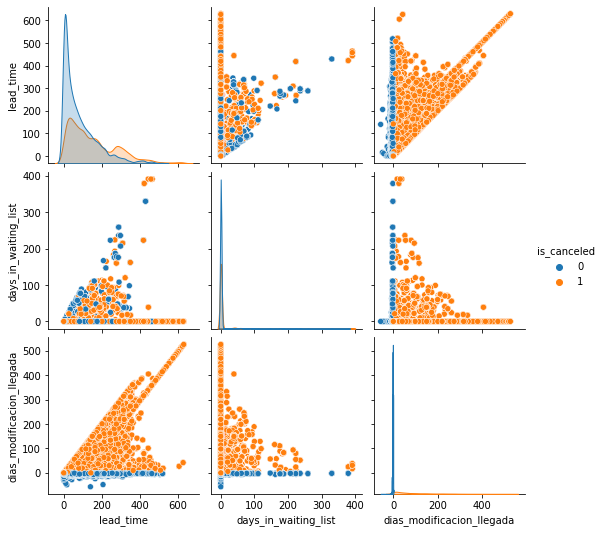

In [61]:
# PAIRPLOT --> lo hacemos en varios para que tarde menos en cargar y se vea mejor


pairplot = sns.pairplot(hotel[['lead_time', 'days_in_waiting_list', 'dias_modificacion_llegada','is_canceled']], kind='scatter', hue='is_canceled')

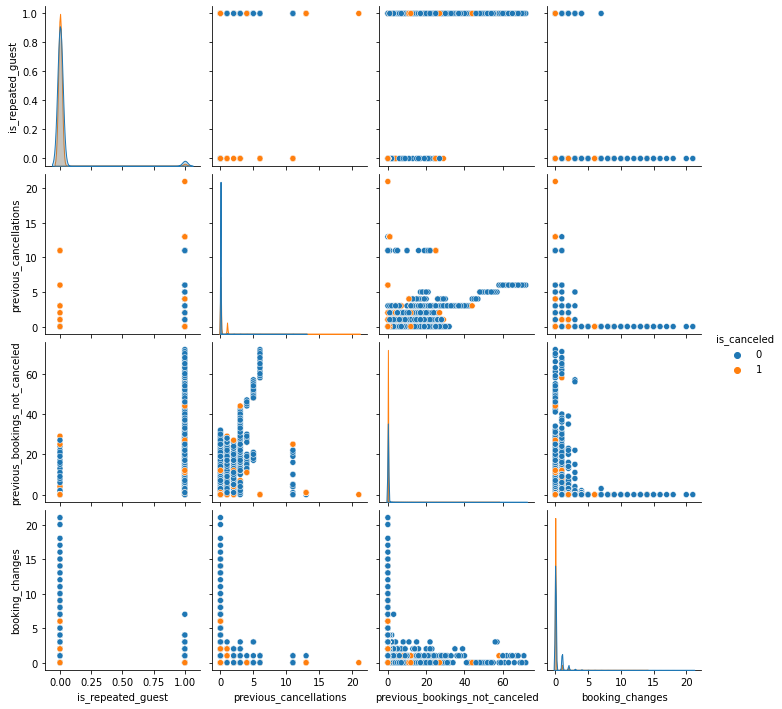

In [62]:
# PAIRPLOT --> separamos variables para poder ver todas en el mismo gráfico

pairplot = sns.pairplot(hotel[['is_repeated_guest','previous_cancellations','previous_bookings_not_canceled',
                                'booking_changes', 'is_canceled']],
                                kind='scatter',
                                hue='is_canceled');

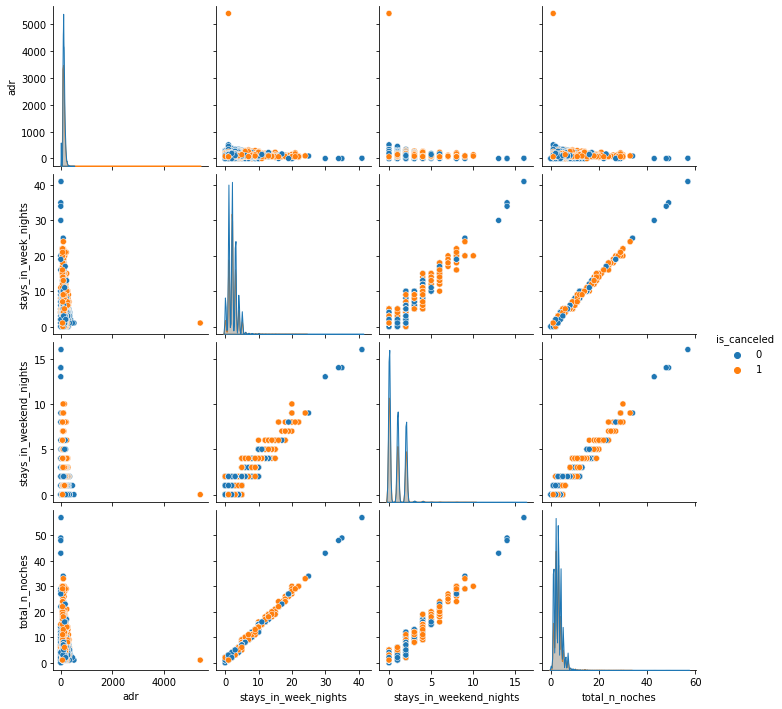

In [63]:
# Relacion lineal positiva entre stays in week night, stay in weekend nights y total n noches --> normal ya que total n noches es la suma de las otras dos

pairplot = sns.pairplot(hotel[['adr','stays_in_week_nights','stays_in_weekend_nights',  'total_n_noches', 'is_canceled']],
                        kind='scatter',
                        hue='is_canceled');

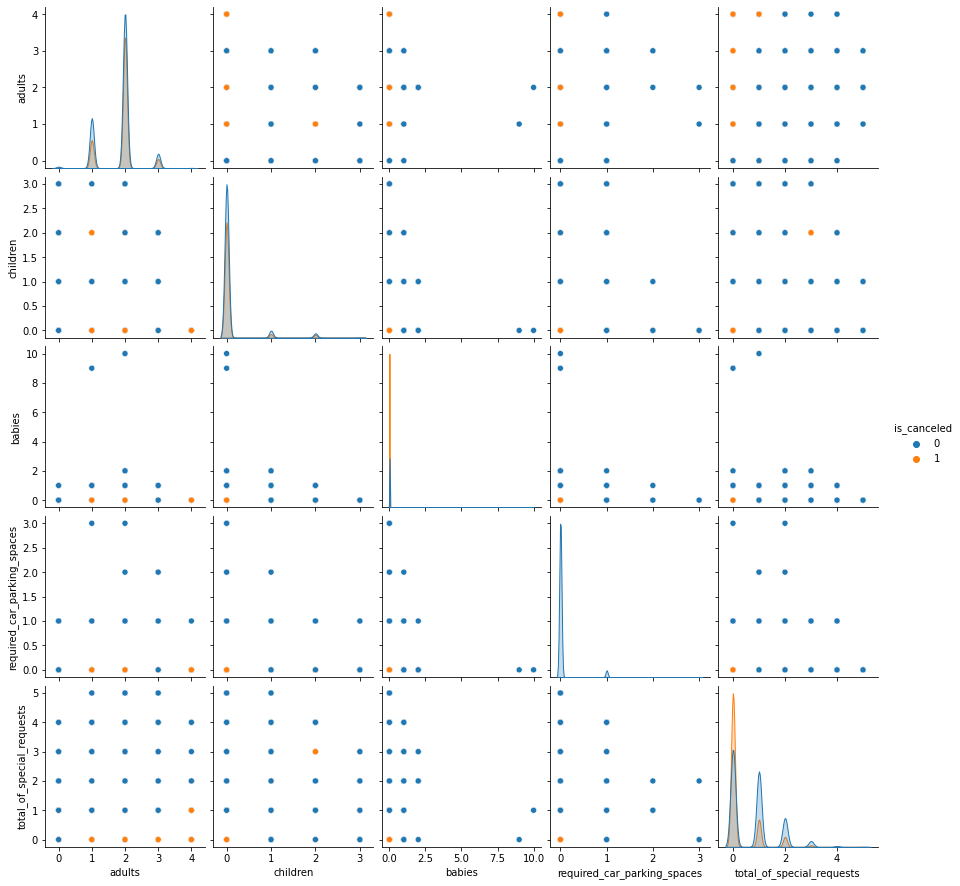

In [64]:
pairplot = sns.pairplot(hotel[['adults','children', 'babies','required_car_parking_spaces', 
                                'total_of_special_requests','is_canceled']],
                        kind='scatter',
                        hue='is_canceled');

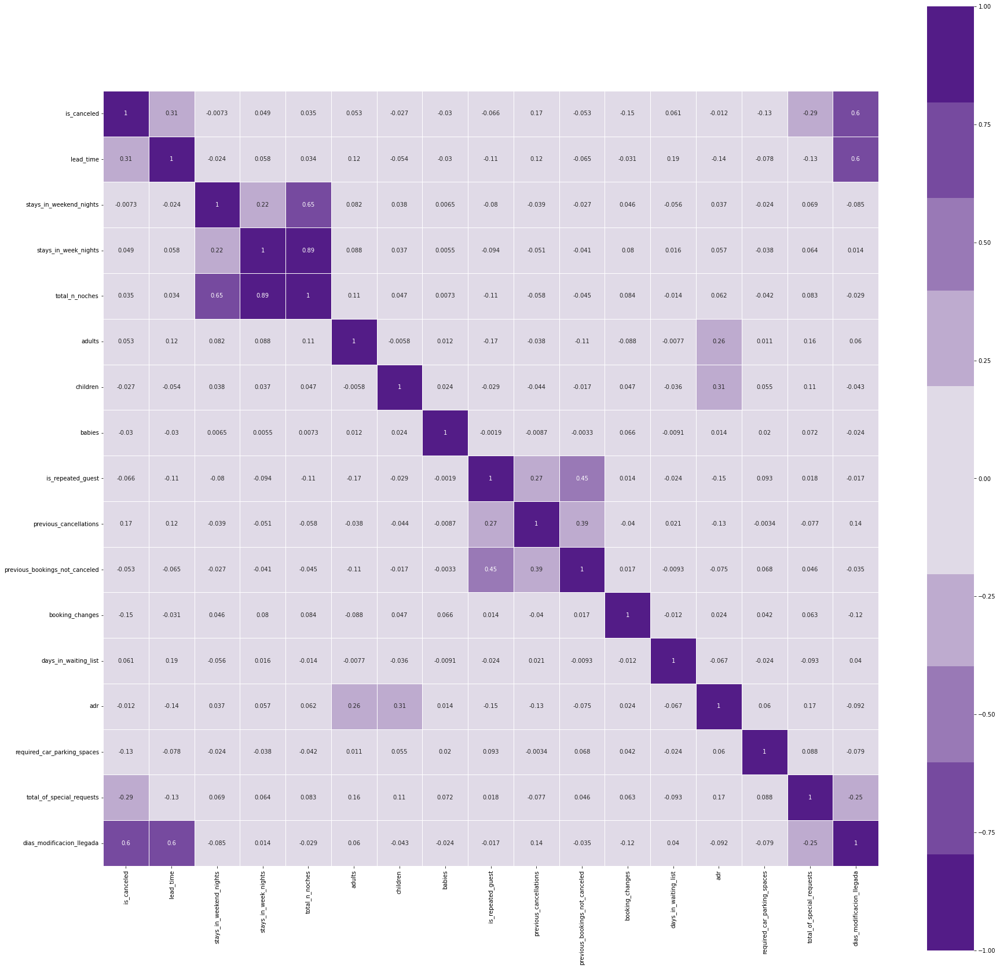

In [65]:
# MATRIZ PEARSON --> no hay correlación lineal con el target en casi ninguna feature
# Establece los límites de colores entre [-1, 1], así como un rango de colores de oscuro a oscuro, pasando por claro (0 correlación)

'''
Vemos mucha relación lineal entre stay_week_nights y total_n_noches (0.89), pero no tanta en stay_weekend_nights (0.22 con semana y 0.6 con total)
'''

plt.figure(figsize=(30,30))
sns.heatmap(hotel[var_numericas].corr(),
           vmin=-1,
           vmax=1,
           center=0,
           cmap=sns.diverging_palette(280, 280, s=85, l=25, n=10),
           square=True,
           annot=True,
           linewidths=.5);

1.3. Fechas


| **Columnas Fechas**| 
| :---|

| **Feature**| **Descripcion**|
| :---| :---|
| 'arrival_date_year'| Año de la fecha de llegada: 2015, 2016 o 2017 |
| 'arrival_date_month' | Mes de la fecha de llegada: de enero a diciembre |
| 'arrival_date_week_number' | Semana del año de la fecha de llegada |
| 'arrival_date_day_of_month | Día del mes de la fecha de llegada: 1 - 31 |
| 'reservation_status_date' | Fecha de la última modificación hecha en la reserva |


In [66]:
# COLUMNAS FECHAS 
# arrival_date y reservation_status_date son las features con mayor variabilidad

traces = []

for columna in hotel[['arrival_date_year', 'arrival_date_month', 'arrival_date_week_number','arrival_date_day_of_month', 'arrival_date', 'reservation_status_date' ]]:

    trace_columna = go.Histogram(x = hotel[columna], autobinx = True, marker_color = '#4620ff')
    traces.append(trace_columna)

fig = make_subplots(rows=3, cols=2, subplot_titles = ['arrival_date_year', 'arrival_date_month', 'arrival_date_week_number','arrival_date_day_of_month', 'arrival_date',  'reservation_status_date'])

fig.append_trace(traces[0], 1, 1)
fig.append_trace(traces[1], 1, 2)
fig.append_trace(traces[2], 2, 1)
fig.append_trace(traces[3], 2, 2)
fig.append_trace(traces[4], 3, 1)
fig.append_trace(traces[5], 3, 2)


fig.update_layout(barmode='group', uniformtext_minsize=12, uniformtext_mode='hide', font_family = 'Arial', title_font_family='Arial', 
                        plot_bgcolor='#efefef', paper_bgcolor='#efefef',showlegend=False)
fig.update_xaxes(visible = False)
fig.update_yaxes(visible = False)

fig.show()

-----

1.4. Variables Categóricas

|**Columnas Categóricas**|
|:---|

**company** : ID de la compañía o entidad que realizó la reserva

**agent**: ID del agente o agencia

**country**: País de procedencia del huésped

**market_segment**: modo de reserva

| **Tipos**|
|:---|
| Direct|
|Corporate|
|Online TA|
|Offline TA/TO|
|Complementary|
|Undefined|
|Aviation|

**distribution_chanel**: Canal de distribución  

| **Tipos**|
|:---|
| Direct|
|Corporate|
|TA/TO|
|Undefined|
| GDS (Global Distribution System)|

**assigned_room_type**: Tipo de habitación asignada

**reserved_room_type**: Tipo de habitación reservada

**reservation_status**: Último estado de la reserva 

| **Tipos**|
|:---|
| Check-Out|
| Canceled |
| No-Show |

**meal**: Paquete de comidas reservado

| **Tipos**|
|:---|
| BB: sólo desayuno|
| HB: desayuno + otra comida |
| FB: desayuno, comida y cena|
| SC/Undefined: ningún paquete |
    
**customer_type**: Tipo de huésped

| **Tipos**|
|:---|
| Contract |
| Group |
|Transient|
| Transient-Party|

**deposit_type**: Indica si el huésped dejo un depósito para garantizar la reserva

| **Tipos**|
|:---|
|No Deposit|
|Refundable|
|Non Refund|

In [67]:
data_report_hotel

COL_N,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,total_n_noches,arrival_date,dias_modificacion_llegada
DATA_TYPE,int64,int64,int64,int64,int64,int64,int64,int64,int64,float64,int64,object,object,object,object,int64,int64,int64,object,object,int64,object,float64,float64,int64,object,float64,int64,int64,object,datetime64[ns],int64,datetime64[ns],int64
MISSINGS (%),0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
UNIQUE_VALUES,2,453,3,12,53,31,14,29,5,4,5,4,167,8,5,2,10,73,8,9,21,3,224,208,115,4,5405,4,6,3,864,37,793,409
CARDIN (%),0.0,0.57,0.0,0.02,0.07,0.04,0.02,0.04,0.01,0.01,0.01,0.01,0.21,0.01,0.01,0.0,0.01,0.09,0.01,0.01,0.03,0.0,0.28,0.26,0.14,0.01,6.81,0.01,0.01,0.0,1.09,0.05,1.0,0.52


In [68]:
# RESUMEN VARIABLES CATEGÓRICAS

var_categoricas = ['meal','country', 'market_segment', 'distribution_channel',
                    'reserved_room_type', 'assigned_room_type', 'deposit_type', 
                    'agent', 'company', 'customer_type', 'reservation_status']

dict_cat = dict()

for columna in var_categoricas:

    n_reservas = len(hotel[columna])
    n_categorias = hotel[columna].nunique()
    perc_card = data_report_hotel.loc["CARDIN (%)"][columna]
    moda = hotel[columna].mode()[0]
    peso_moda = round(len(hotel[hotel[columna] == hotel[columna].mode()[0]]) / hotel.shape[0] * 100, 2)

    dict_cat[columna] = [n_reservas, n_categorias, perc_card, moda, peso_moda]

resumen_categoricas = pd.DataFrame(dict_cat).T
resumen_categoricas.columns = ['N_observaciones', 'N_Categorias', 'CARD (%)', 'Moda', 'Peso_Moda']
resumen_categoricas.sort_values(by='Peso_Moda')

# solo en 4 de las 11 features no hay una categoría que domina --> en realidad son 3, porque company tiene +90% nulos y la vamos a eliminar
# ¿features poco representativas?

,N_observaciones,N_Categorias,CARD (%),Moda,Peso_Moda
country,79330,167,0.21,PRT,39.03
agent,79330.0,224.0,0.28,9.0,40.28
market_segment,79330,8,0.01,Online TA,48.84
reservation_status,79330,3,0.0,Check-Out,58.27
assigned_room_type,79330,9,0.01,A,71.86
customer_type,79330,4,0.01,Transient,74.88
meal,79330,4,0.01,BB,78.54
reserved_room_type,79330,8,0.01,A,78.9
deposit_type,79330,3,0.0,No Deposit,83.75
distribution_channel,79330,5,0.01,TA/TO,86.91


In [69]:
# Función Gráfico de Barras

def var_cat_grafico_barras(peso, categorias, feature):    

    fig = px.bar(x =categorias,  y = peso, text = peso, title= feature)
    fig.update_layout(barmode='group', uniformtext_minsize=12, uniformtext_mode='hide', font_family = 'Arial', title_font_family='Arial', 
                            plot_bgcolor='#efefef', paper_bgcolor='#efefef',showlegend=False, xaxis_title="Categorías",)

    fig.update_traces(texttemplate='%{text:.f}')
    fig.update_xaxes()
    fig.update_yaxes(visible = False)

    fig.show()

In [70]:
# Gráfico de barras para ver cómo estan repartidas las categorías dentro de cada variable
# La mayoría de las variables tienen una categoría mayoritaria que define la variable

for feature in var_categoricas:

    peso_cats = hotel[feature].value_counts().reset_index()
    peso_cats.columns = [feature, 'peso']
    peso_cats['peso'] = round(peso_cats['peso'].apply(lambda x : x / hotel.shape[0]), 2)

    var_cat_grafico_barras(peso_cats['peso'], peso_cats[feature], feature)

1.5. Correlación Lineal - Todas las Variables --> MATRIZ PHIK

interval columns not set, guessing: ['is_canceled', 'lead_time', 'arrival_date_year', 'arrival_date_month', 'arrival_date_week_number', 'arrival_date_day_of_month', 'stays_in_weekend_nights', 'stays_in_week_nights', 'adults', 'children', 'babies', 'is_repeated_guest', 'previous_cancellations', 'previous_bookings_not_canceled', 'booking_changes', 'agent', 'company', 'days_in_waiting_list', 'adr', 'required_car_parking_spaces', 'total_of_special_requests', 'total_n_noches', 'dias_modificacion_llegada']


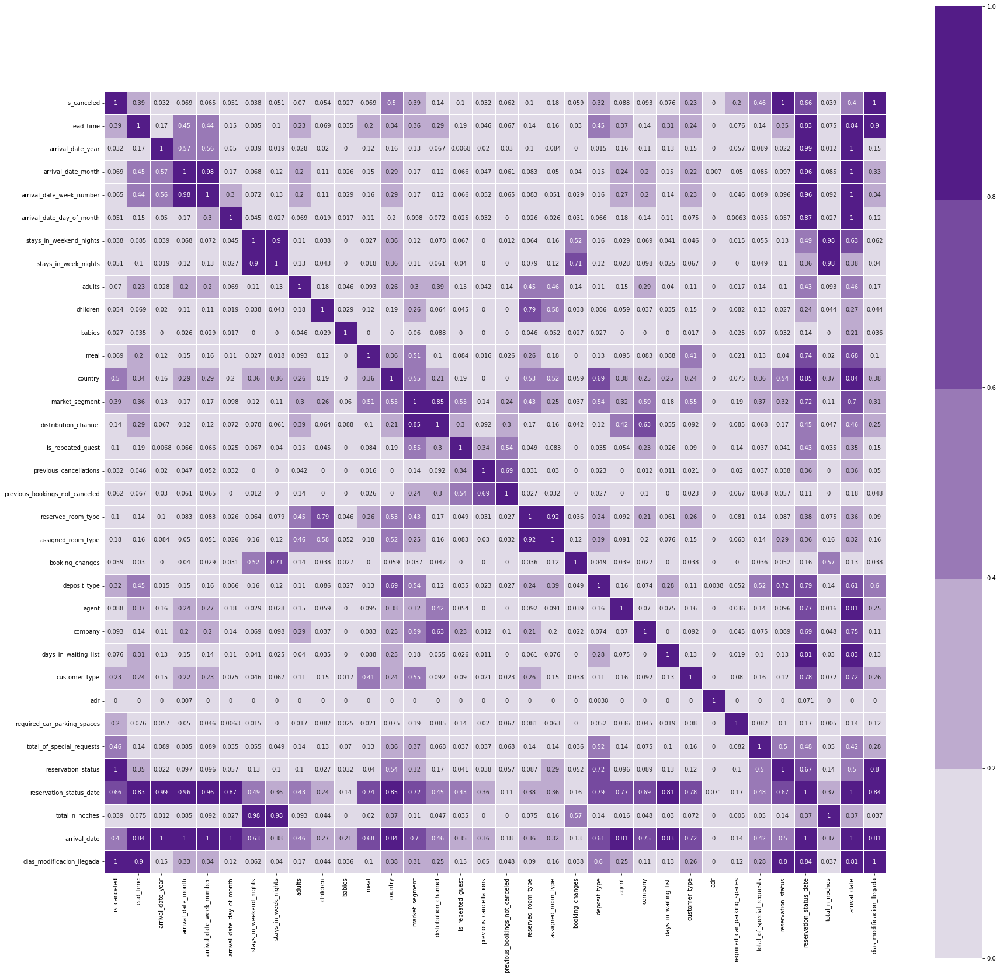

In [71]:
# matriz phik para ver la correlación entre variables de distinto tipo
'''
MUY POCA CORRELACIÓN LINEAL CON EL TARGET
- Destaca la feature creada: 'dias_modificacion_llegada', la única con una correlación muy alta
- reservation_status_date: 0.66 (pero correlación de 0.8 con 'dias_modificacion_llegada)
- country: 0.5
'''

phik_matrix = hotel.phik_matrix()

plt.figure(figsize=(30,30))
sns.heatmap(phik_matrix,
            vmin=0,
            vmax=1,
            center=0,
            cmap=sns.diverging_palette(145, 280, s=85, l=25, n=10),
            square=True,
            annot=True,
            linewidths=.5);